# Worksheet 07

Name:  Prathmesh Sonawane

UID: U39215370 

### Topics

- Density-Based Clustering

### Density-Based Clustering

Follow along with the live coding of the DBScan algorithm.

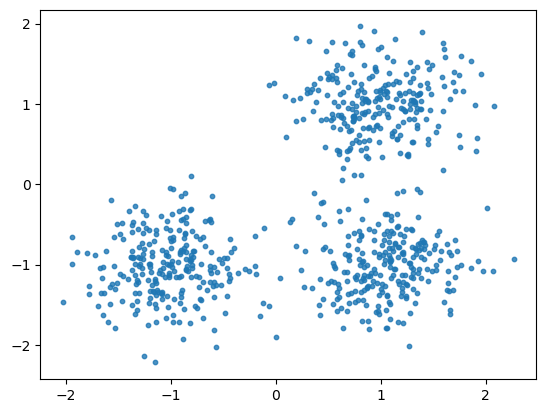

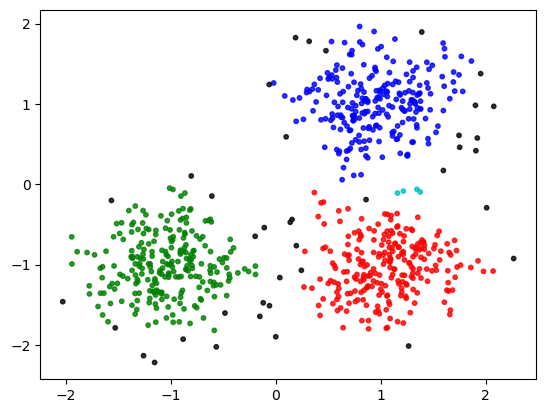

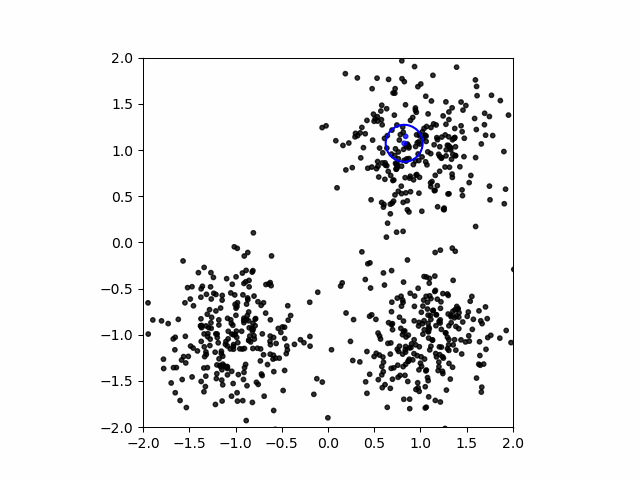

In [82]:
import numpy as np
import matplotlib.pyplot as plt
import sklearn.datasets as datasets
from PIL import Image as im
from IPython.display import Image, display



TEMPFILE = 'temp.png'

centers = [[1, 1], [-1, -1], [1, -1]]
X, _ = datasets.make_blobs(n_samples=750, centers=centers, cluster_std=0.4,
                            random_state=0)

plt.scatter(X[:,0],X[:,1],s=10, alpha=0.8)
plt.show()

class DBC():

    def __init__(self, dataset, min_pts, epsilon):
        self.dataset = dataset
        self.min_pts = min_pts
        self.epsilon = epsilon
        self.assignment = [-1 for _ in range(len(self.dataset))]
        self.snaps = []


    def snapshot(self, nextPoint):

        colors = np.array([x for x in 'bgrcmykbgrcmykbgrcmykbgrcmyk'])
        colors = np.hstack([colors] * 200)

        fig, ax = plt.subplots()
        ax.scatter(X[:, 0], X[:, 1], color=colors[self.assignment].tolist(), s=10, alpha=0.8)
        cir = plt.Circle( self.dataset[nextPoint], self.epsilon, edgecolor='blue', fill=False, linewidth=1.5) # create circle around the point assigned
        ax.add_patch(cir)
        ax.set_xlim(-2,2)
        ax.set_ylim(-2,2)
        ax.set_aspect('equal') # necessary or else the circles appear to be oval shaped

        fig.savefig(TEMPFILE)
        plt.close()

        self.snaps.append(im.fromarray(np.asarray(im.open(TEMPFILE))))

    def distance(self, i,j):
        return np.linalg.norm(self.dataset[i] - self.dataset[j])

    def is_core(self,i):
        neihgborhood = 0
        for j in range (len(self.dataset)):
            if i != j and self.distance(i,j) <= self.epsilon: 
                neihgborhood+=1
            
        return neihgborhood >= self.min_pts

    
    def get_neighborhood(self, i):
        neihgborhood = []
        for j in range (len(self.dataset)):
            if i != j and self.distance(i,j) <= self.epsilon: 
                neihgborhood.append(j)
            
        return neihgborhood

    def get_unassignedneighborhood(self, i):
        neighborhood = self.get_neighborhood(i)
        return[point for point in neighborhood if self.assignment[point] == -1]


    def make_cluster(self, i, cluster_num):
        self.assignment[i] = cluster_num

        neighborhood_queue = self.get_neighborhood(i)

        while (neighborhood_queue):
            next_pt = neighborhood_queue.pop()

            if (self.assignment[next_pt] !=-1):
                continue

            
            self.assignment[next_pt] = cluster_num
            self.snapshot(next_pt)
            if self.is_core(next_pt):
                neighborhood_queue +=self.get_unassignedneighborhood(next_pt)

        return 


    def dbscan(self):
        """
        returns a list of assignments. The index of the
        assignment should match the index of the data point
        in the dataset.
        """
        
        cluster_num = 0

        for i in range (len (self.dataset)):
            if (self.assignment[i] != -1):
                continue
            if self.is_core(i):
                self.make_cluster(i, cluster_num)
                cluster_num+=1

        return self.assignment

cluster = DBC(X, 3, .2)
clustering = cluster.dbscan()

cluster.snaps[0].save(
    'dbscan.gif',
    optimize=False,
    save_all=True,
    append_images=cluster.snaps[1:],
    loop=0,
    duration=70
)

colors = np.array([x for x in 'bgrcmykbgrcmykbgrcmykbgrcmyk'])
colors = np.hstack([colors] * 200)
plt.scatter(X[:, 0], X[:, 1], color=colors[clustering].tolist(), s=10, alpha=0.8)
plt.show()

display(Image(filename='dbscan.gif'))

## Challenge Problem

Using the code above and the template provided below, create the animation below of the DBScan algorithm.

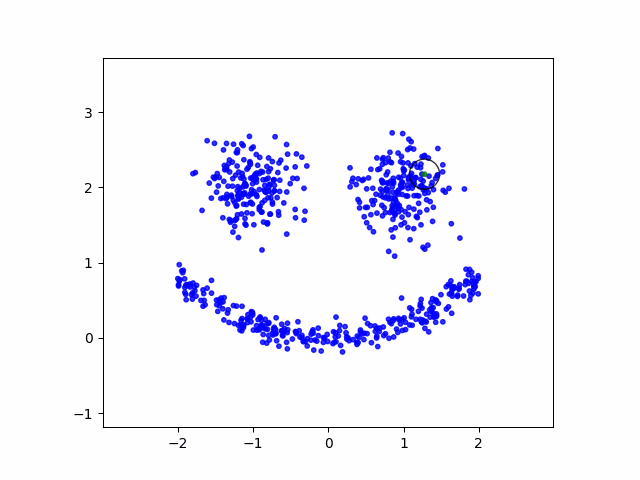

In [2]:
from IPython.display import Image
Image(filename="dbscan_2.gif", width=500, height=500)

Hints:

- First animate the dbscan algorithm for the dataset used in class (before trying to create the above dataset)
- Take a snapshot of the assignments when the point gets assigned to a cluster
- Confirm that the snapshot works by saving it to a file
- Don't forget to close the matplotlib plot after saving the figure
- Gather the snapshots in a list of images that you can then save as a gif using the code below
- Use `ax.set_aspect('equal')` so that the circles don't appear to be oval shaped
- To create the above dataset you need two blobs for the eyes. For the mouth you can use the following process to generate (x, y) pairs:
  - Pick an x at random in an interval that makes sense given where the eyes are positioned
  - For that x generate y that is 0.2 * x^2 plus a small amount of randomness
  - `zip` the x's and y's together and append them to the dataset containing the blobs

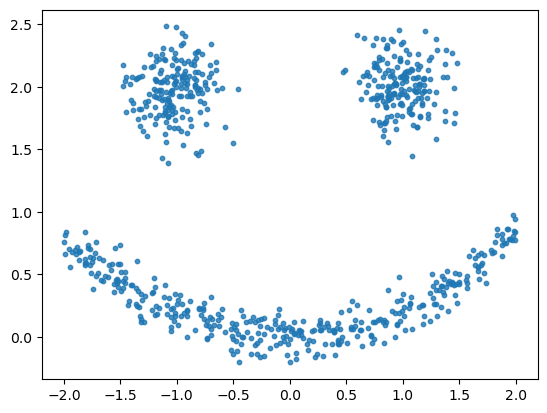

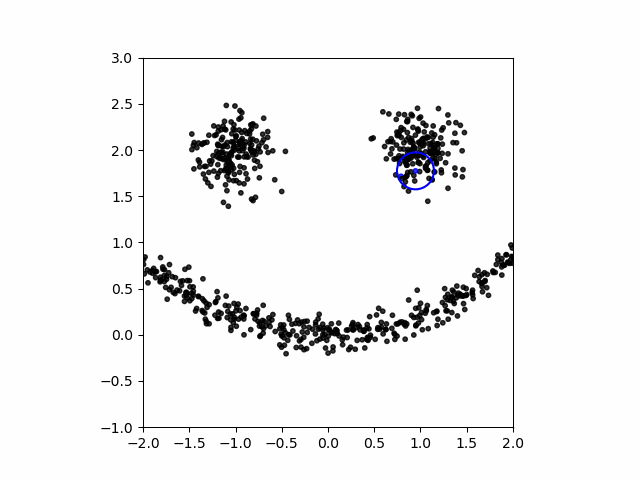

In [86]:
import numpy as np
from PIL import Image as im
import matplotlib.pyplot as plt
import sklearn.datasets as datasets
from IPython.display import Image, display

TEMPFILE1 = 'temp1.png'

class DBC():

    def __init__(self, dataset, min_pts, epsilon):
        self.dataset = dataset
        self.min_pts = min_pts
        self.epsilon = epsilon
        self.assignment = [-1 for _ in range(len(self.dataset))]
        self.snaps = []


    def snapshot(self, nextPoint):

        colors = np.array([x for x in 'bgrcmykbgrcmykbgrcmykbgrcmyk'])
        colors = np.hstack([colors] * 200)

        fig, ax = plt.subplots()
        ax.scatter(face[:, 0], face[:, 1], color=colors[self.assignment].tolist(), s=10, alpha=0.8)
        cir = plt.Circle( self.dataset[nextPoint], self.epsilon, edgecolor='blue', fill=False, linewidth=1.5) # create circle around the point assigned
        ax.add_patch(cir)
        ax.set_xlim(-2,2)
        ax.set_ylim(-1,3)
        ax.set_aspect('equal') # necessary or else the circles appear to be oval shaped

        fig.savefig(TEMPFILE1)
        plt.close()

        self.snaps.append(im.fromarray(np.asarray(im.open(TEMPFILE1))))

    def distance(self, i,j):
        return np.linalg.norm(self.dataset[i] - self.dataset[j])

    def is_core(self,i):
        neihgborhood = 0
        for j in range (len(self.dataset)):
            if i != j and self.distance(i,j) <= self.epsilon: 
                neihgborhood+=1
            
        return neihgborhood >= self.min_pts

    
    def get_neighborhood(self, i):
        neihgborhood = []
        for j in range (len(self.dataset)):
            if i != j and self.distance(i,j) <= self.epsilon: 
                neihgborhood.append(j)
            
        return neihgborhood

    def get_unassignedneighborhood(self, i):
        neighborhood = self.get_neighborhood(i)
        return[point for point in neighborhood if self.assignment[point] == -1]


    def make_cluster(self, i, cluster_num):
        self.assignment[i] = cluster_num

        neighborhood_queue = self.get_neighborhood(i)

        while (neighborhood_queue):
            next_pt = neighborhood_queue.pop()

            if (self.assignment[next_pt] !=-1):
                continue

            
            self.assignment[next_pt] = cluster_num
            self.snapshot(next_pt)
            if self.is_core(next_pt):
                neighborhood_queue +=self.get_unassignedneighborhood(next_pt)

        return 


    def dbscan(self):
        """
        returns a list of assignments. The index of the
        assignment should match the index of the data point
        in the dataset.
        """
        
        cluster_num = 0

        for i in range (len (self.dataset)):
            if (self.assignment[i] != -1):
                continue
            if self.is_core(i):
                self.make_cluster(i, cluster_num)
                cluster_num+=1

        return self.assignment



##Below, Create the plots. 


centers = [[1, 2], [-1, 2], [0, 0]]
eyes, _ = datasets.make_blobs(n_samples=375, centers=[[1, 2], [-1, 2]], cluster_std=0.2,
                            random_state=0)

mouth_x = np.random.uniform(-2, 2, 375)
mouth_y = 0.2 * mouth_x ** 2 + 0.1 * np.random.randn(375)
smile_points = list(zip(mouth_x, mouth_y))

face = np.append(eyes, smile_points, axis=0)


plt.scatter(face[:,0],face[:,1],s=10, alpha=0.8)
plt.show()

dbc = DBC(face, 3, 0.2)
clustering = dbc.dbscan()

dbc.snaps[0].save(
    'dbscan2.gif',
    optimize=False,
    save_all=True,
    append_images=dbc.snaps[1:],
    loop=0,
    duration=25
)

display(Image(filename='dbscan2.gif'))